In [1]:
%matplotlib inline
import tables
import matplotlib.pylab as plt

filename = '/Users/ajaver/Desktop/Gecko_compressed/Results/20150521_1115/Capture_Ch3_21052015_111806_features.hdf5';
with tables.File(filename, 'r') as fid:
    feature_means = fid.get_node('/features_means');

    worm_indexes = feature_means.cols.worm_index[:];
    print(worm_indexes)

[ 4.  5.]


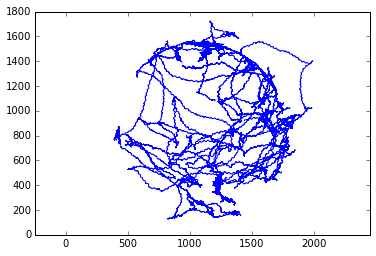

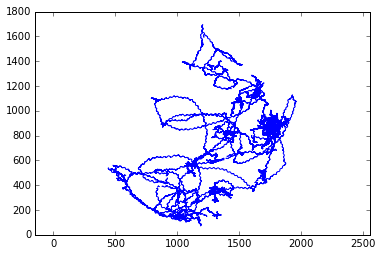

In [12]:
mid_point = 25
with tables.File(filename, 'r') as fid:
    for w_ind in worm_indexes:
        node_name = '/features/worm_%i/skeletons' % w_ind;
        skeletons = fid.get_node(node_name)[:,mid_point,:];
        xx = skeletons[:,0]
        yy = skeletons[:,1]
        plt.figure()
        plt.plot(xx,yy)
        plt.xlim([0,2048])
        plt.xlim([0,2048])
        plt.axis('equal')

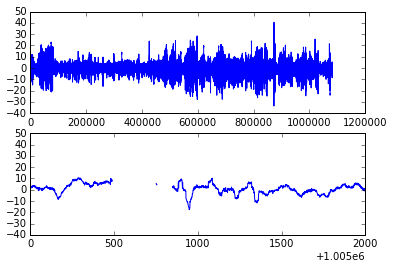

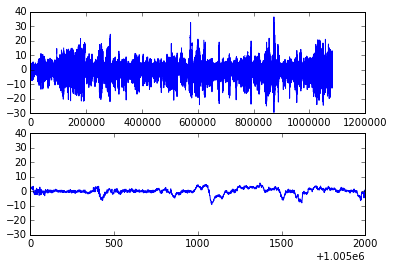

In [3]:
with tables.File(filename, 'r') as fid:
    for ii, w_ind in enumerate(worm_indexes):
        node_name = '/features/worm_%i/locomotion' % w_ind;
        motion_table = fid.get_node(node_name);
        
        #if ii == 0: print(motion_table.colnames)
        
        frames = motion_table.cols.frame_number[:]
        w_speed = motion_table.cols.midbody_speed[:]
        w_area = motion_table.cols.area[:]
        
        plt.figure()
        plt.subplot(2,1,1)
        plt.plot(frames, w_speed )
        #plt.ylabel('Midbody speed')
        
        plt.subplot(2,1,2)
        plt.plot(frames, w_speed)
        #plt.ylabel('Area')
        plt.xlim([1005000, 1007000])


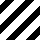
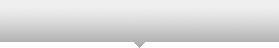
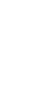
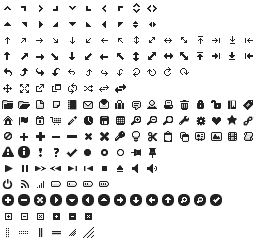
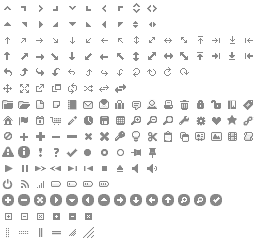
...
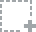
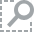
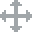
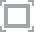
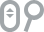

In [8]:
#import bokeh.plotting as bok

# output to static HTML file
p = bok.output_notebook()

# create a new plot with a title and axis labels
p = bok.figure(title="Velocity", x_axis_label='', y_axis_label='')

# add a line renderer with legend and line thickness
p.line(frames, w_speed, line_width=2)

# show the results
bok.show(p)

AttributeError: 'module' object has no attribute 'line'